<a href="https://colab.research.google.com/github/NicholasDow/Folder-of-Fail/blob/main/Tiger_Jaguar_CycleGan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch 
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt 

In [ ]:
class ResidualBlock(nn.Module):
  def __init__(self, input_channels):
    super().__init__()
    self.conv1 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding = 1, padding_mode='reflect')
    self.conv2 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding = 1, padding_mode='reflect')
    self.instancenorm = nn.InstanceNorm2d(input_channels) # for covariate shift
    self.activation = nn.ReLU()
  def forward(self, x):
     base_image = x.clone() #going to keep the original image and just overlay on top
     x = self.conv1(x)
     x = self.instancenorm(x)
     x = self.activation(x)
     x = self.conv2(x)
     x = self.instancenorm(x)
     return base_image + x #the adding part here is what makes it residual

In [ ]:
class ContBlock(nn.Module):
  def __init__(self, input_channels, use_bn=True, kernel_size = 3, activation='relu'):
    super().__init__()
    self.conv1 = nn.Conv2d(input_channels, input_channels * 2, kernel_size = kernel_size, stride = 2, padding = 1, padding_mode='reflect')
    self.activation = nn.ReLU() if activation == 'relu' else nn.LeakyReLU(0.2)
    if use_bn:
      self.instancenorm = nn.InstanceNorm2d(input_channels * 2)
    self.use_bn = use_bn
  def forward(self, x):
    x = self.conv1(x)
    if self.use_bn:
      x = self.instancenorm(x)
    x = self.activation(x)
    return x

In [ ]:
class ExpBlock(nn.Module):
  def __init__(self, input_channels, use_bn = True):
    super().__init__()
    self.conv1 = nn.ConvTranspose2d(input_channels, input_channels // 2, kernel_size=3, stride=2, padding=1, output_padding=1)
    if use_bn:
        self.instancenorm = nn.InstanceNorm2d(input_channels // 2)
    self.use_bn = use_bn
    self.activation = nn.ReLU()
  def forward(self, x):
    x = self.conv1(x)
    if self.use_bn:
      x = self.instancenorm(x)
    x = self.activation(x)
    return x

In [ ]:
class FeatureMapBlock(nn.Module):
  def __init__(self, input_channels, output_channels):
    super().__init__()
    self.conv1 = nn.Conv2d(input_channels, output_channels, kernel_size = 7, padding = 3, padding_mode = 'reflect')
  def forward(self,x):
    x = self.conv1(x)
    return x

In [ ]:
class Generator(nn.Module):
  def __init__(self, input_channels, output_channels, hidden_channels = 64):
    super().__init__()
    self.startshape = FeatureMapBlock(input_channels, hidden_channels)
    self.contract1 = ContBlock(hidden_channels)
    self.contract2 = ContBlock(hidden_channels * 2)
    res_mult = 4
    self.res0 = ResidualBlock(hidden_channels * res_mult)
    self.res1 = ResidualBlock(hidden_channels * res_mult)
    self.res2 = ResidualBlock(hidden_channels * res_mult)
    self.res3 = ResidualBlock(hidden_channels * res_mult)
    self.res4 = ResidualBlock(hidden_channels * res_mult)
    self.res5 = ResidualBlock(hidden_channels * res_mult)
    self.res6 = ResidualBlock(hidden_channels * res_mult)
    self.res7 = ResidualBlock(hidden_channels * res_mult)
    self.res8 = ResidualBlock(hidden_channels * res_mult)
    self.expand2 = ExpBlock(hidden_channels * 4)
    self.expand3 = ExpBlock(hidden_channels * 2)
    self.endshape = FeatureMapBlock(hidden_channels, output_channels)
    self.tanh = torch.nn.Tanh()
  def forward(self, x):
    x0 = self.startshape(x)
    x1 = self.contract1(x0)
    x2 = self.contract2(x1)
    x3 = self.res0(x2)
    x4 = self.res1(x3)
    x5 = self.res2(x4)
    x6 = self.res3(x5)
    x7 = self.res4(x6)
    x8 = self.res5(x7)
    x9 = self.res6(x8)
    x10 = self.res7(x9)
    x11 = self.res8(x10)
    x12 = self.expand2(x11)
    x13 = self.expand3(x12)
    xn = self.endshape(x13)
    return self.tanh(xn)

In [ ]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_channels, hidden_channels=64):
        super().__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContBlock(hidden_channels, use_bn=False, kernel_size=4, activation='lrelu')
        self.contract2 = ContBlock(hidden_channels * 2, kernel_size=4, activation='lrelu')
        self.contract3 = ContBlock(hidden_channels * 4, kernel_size=4, activation='lrelu')
        self.final = nn.Conv2d(hidden_channels * 8 , 1, kernel_size=1)
    def forward(self, x):
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.contract3(x2)
        xn = self.final(x3)
        return xn

In [ ]:

n_epochs = 10
dim_A, dim_B = 3,3
display_step = 100
batch_size = 1
lr = 0.0002
load_shape = 256
target_shape = 256
device = 'cuda'

In [ ]:
import glob
import random
import os
from torch.utils.data import Dataset
from PIL import Image
# Inspired by https://github.com/aitorzip/PyTorch-CycleGAN/blob/master/datasets.py
class ImageDataset(Dataset):
    def __init__(self, root, transform=None, mode='train'):
        self.transform = transform
        self.files_A = sorted(glob.glob(os.path.join(root, '%sA' % mode) + '/*.*'))
        self.files_B = sorted(glob.glob(os.path.join(root, '%sB' % mode) + '/*.*'))
        if len(self.files_A) > len(self.files_B):
            self.files_A, self.files_B = self.files_B, self.files_A
        self.new_perm()
        assert len(self.files_A) > 0, "Make sure you downloaded the images!"

    def new_perm(self):
        self.randperm = torch.randperm(len(self.files_B))[:len(self.files_A)]

    def __getitem__(self, index):
        item_A = self.transform(Image.open(self.files_A[index % len(self.files_A)]))
        item_B = self.transform(Image.open(self.files_B[self.randperm[index]]))
        if item_A.shape[0] != 3: 
            item_A = item_A.repeat(3, 1, 1)
        if item_B.shape[0] != 3: 
            item_B = item_B.repeat(3, 1, 1)
        if index == len(self) - 1:
            self.new_perm()
        # Old versions of PyTorch didn't support normalization for different-channeled images Nick Dow was here
        return (item_A - 0.5) * 2, (item_B - 0.5) * 2

    def __len__(self):
        return min(len(self.files_A), len(self.files_B))

In [ ]:

transform = transforms.Compose([
    transforms.Resize(load_shape),
    transforms.RandomCrop(target_shape),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
])

import torchvision
dataset = ImageDataset("drive/MyDrive/Jaguar2Tiger", transform=transform)

In [ ]:
gen_AB = Generator(dim_A, dim_B).to(device)
gen_BA = Generator(dim_B, dim_A).to(device)
gen_opt = torch.optim.Adam(list(gen_AB.parameters()) + list(gen_BA.parameters()), lr=lr, betas=(0.5, 0.999))
disc_A = PatchDiscriminator(dim_A).to(device)
disc_A_opt = torch.optim.Adam(disc_A.parameters(), lr=lr, betas=(0.5, 0.999))
disc_B = PatchDiscriminator(dim_B).to(device)
disc_B_opt = torch.optim.Adam(disc_B.parameters(), lr=lr, betas=(0.5, 0.999))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

In [ ]:
gen_AB = gen_AB.apply(weights_init)
gen_BA = gen_BA.apply(weights_init)
disc_A = disc_A.apply(weights_init)
disc_B = disc_B.apply(weights_init)

In [ ]:
def get_disc_loss(real_X, fake_X, disc_X, adv_criterion):
    disc_fake_X_hat = disc_X(fake_X.detach()) # Detach generator
    disc_fake_X_loss = adv_criterion(disc_fake_X_hat, torch.zeros_like(disc_fake_X_hat))
    disc_real_X_hat = disc_X(real_X)
    disc_real_X_loss = adv_criterion(disc_real_X_hat, torch.ones_like(disc_real_X_hat))
    disc_loss = (disc_fake_X_loss + disc_real_X_loss) / 2
    return disc_loss

In [ ]:
def get_gen_adversarial_loss(real_X, disc_Y, gen_XY, adv_criterion):
    fake_Y = gen_XY(real_X)
    disc_fake_Y_hat = disc_Y(fake_Y)
    adversarial_loss = adv_criterion(disc_fake_Y_hat, torch.ones_like(disc_fake_Y_hat))
    return adversarial_loss, fake_Y

In [ ]:
def get_identity_loss(real_X, gen_YX, identity_criterion):
    identity_X = gen_YX(real_X)
    identity_loss = identity_criterion(identity_X, real_X)
    return identity_loss, identity_X

In [ ]:
def get_cycle_consistency_loss(real_X, fake_Y, gen_YX, cycle_criterion):
    cycle_X = gen_YX(fake_Y)
    cycle_loss = cycle_criterion(cycle_X, real_X)
    return cycle_loss, cycle_X

In [ ]:
def get_gen_loss(real_A, real_B, gen_AB, gen_BA, disc_A, disc_B, adv_criterion, identity_criterion, cycle_criterion, lambda_identity=0.1, lambda_cycle=10):
    adv_loss_BA, fake_A = get_gen_adversarial_loss(real_B, disc_A, gen_BA, adv_criterion)
    adv_loss_AB, fake_B = get_gen_adversarial_loss(real_A, disc_B, gen_AB, adv_criterion)
    gen_adversarial_loss = adv_loss_BA + adv_loss_AB

    identity_loss_A, identity_A = get_identity_loss(real_A, gen_BA, identity_criterion)
    identity_loss_B, identity_B = get_identity_loss(real_B, gen_AB, identity_criterion)
    gen_identity_loss = identity_loss_A + identity_loss_B

    cycle_loss_BA, cycle_A = get_cycle_consistency_loss(real_A, fake_B, gen_BA, cycle_criterion)
    cycle_loss_AB, cycle_B = get_cycle_consistency_loss(real_B, fake_A, gen_AB, cycle_criterion)
    gen_cycle_loss = cycle_loss_BA + cycle_loss_AB

    gen_loss = lambda_identity * gen_identity_loss + lambda_cycle * gen_cycle_loss + gen_adversarial_loss
    return gen_loss, fake_A, fake_B

In [ ]:
import torch.nn.functional as F

adv_criterion = nn.MSELoss() 
recon_criterion = nn.L1Loss()

In [ ]:
torch.cuda.get_device_properties(device).total_memory

16945512448

In [ ]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    image_tensor = (image_tensor + 1) / 2
    image_shifted = image_tensor
    image_unflat = image_shifted.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

Epoch 0: Step 0: Generator (U-Net) loss: 0.15316522598266602, Discriminator loss: 0.0045953398942947385


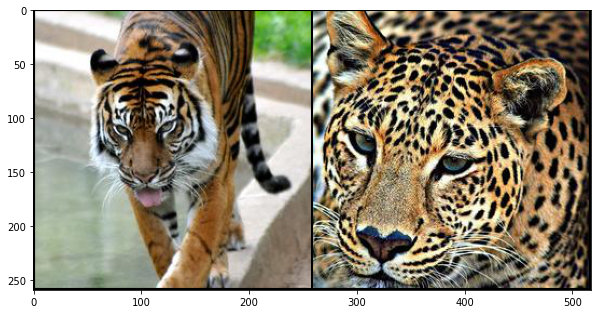

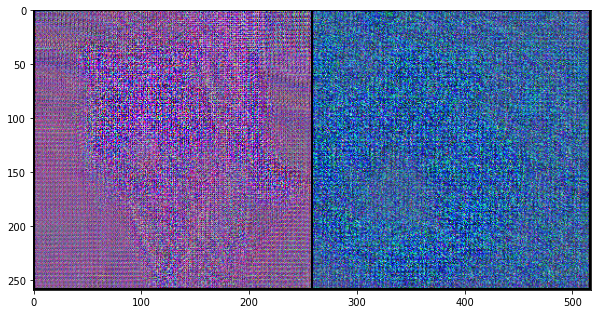

Epoch 0: Step 100: Generator (U-Net) loss: 7.265405054092407, Discriminator loss: 0.24461914852261535


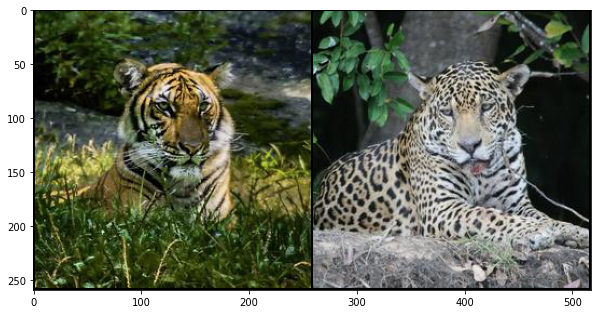

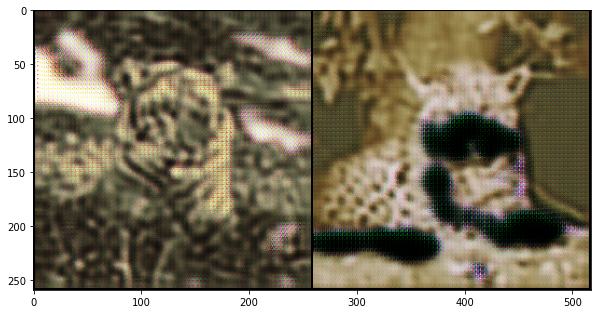

Epoch 0: Step 200: Generator (U-Net) loss: 6.4520432806015, Discriminator loss: 0.18614711523056027


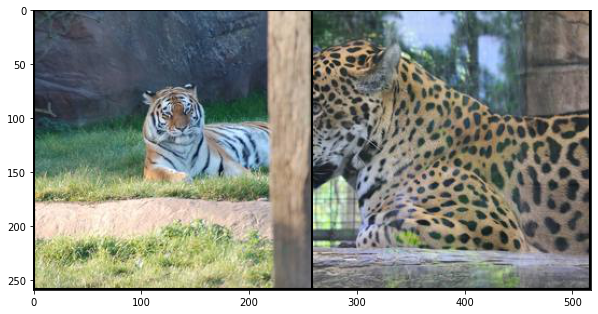

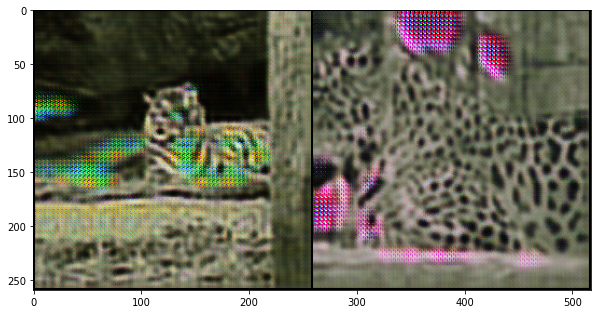

Epoch 0: Step 300: Generator (U-Net) loss: 6.242384328842161, Discriminator loss: 0.17903169766068455


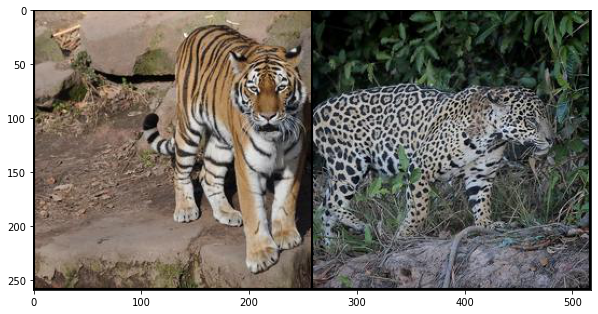

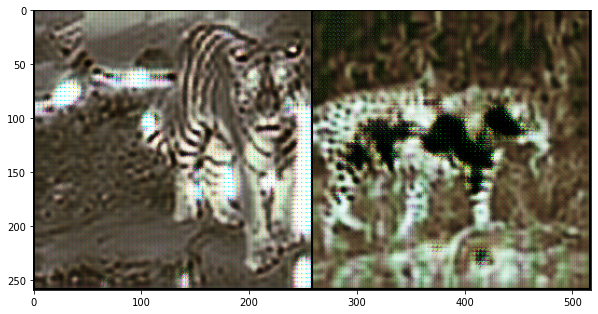

Epoch 0: Step 400: Generator (U-Net) loss: 6.18319767475128, Discriminator loss: 0.1959925650060177


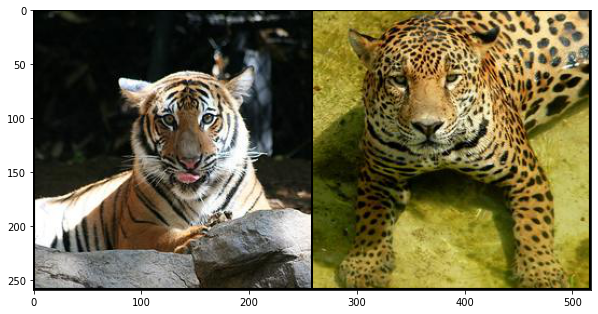

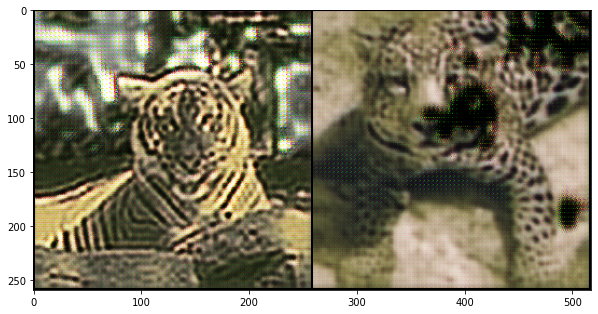

Epoch 0: Step 500: Generator (U-Net) loss: 5.706042904853819, Discriminator loss: 0.23694261610507972


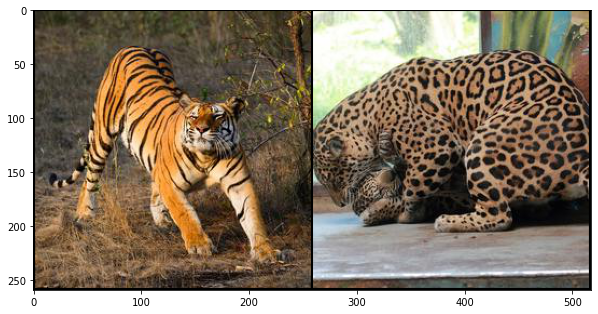

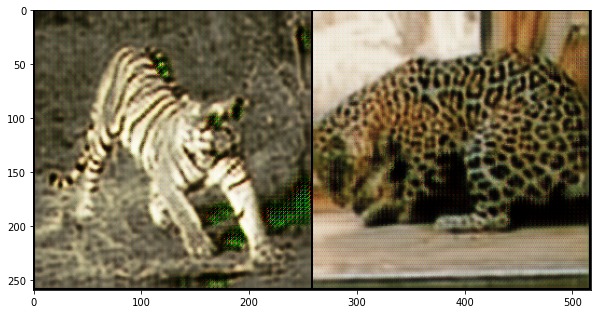

Epoch 0: Step 600: Generator (U-Net) loss: 5.4371742391586295, Discriminator loss: 0.23590786784887305


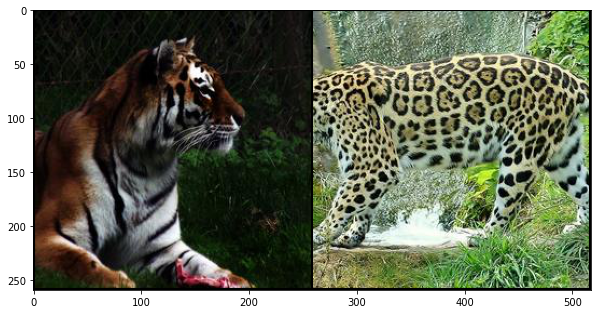

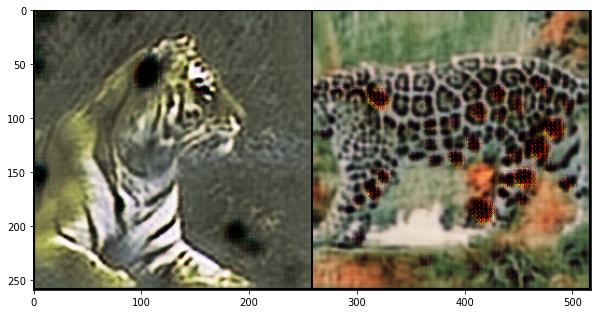

Epoch 0: Step 700: Generator (U-Net) loss: 5.4240751504898075, Discriminator loss: 0.24205555662512782


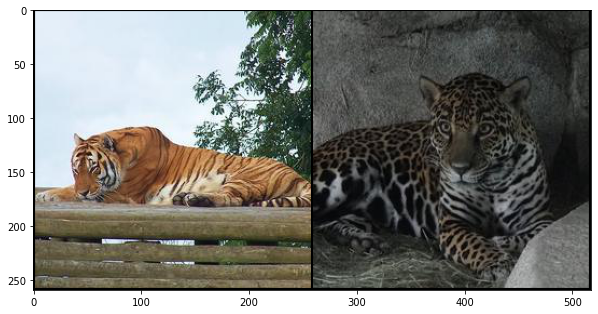

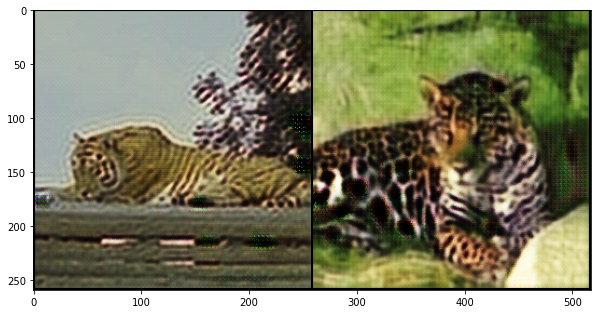

Epoch 0: Step 800: Generator (U-Net) loss: 5.245268304347995, Discriminator loss: 0.23168058723211288


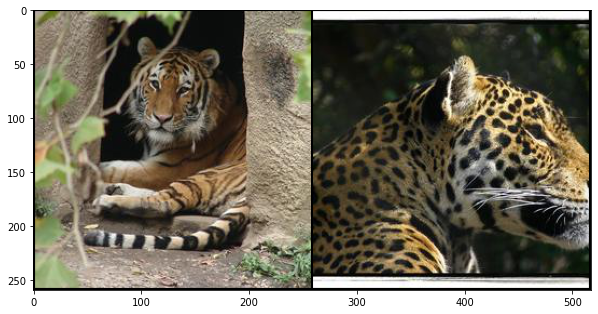

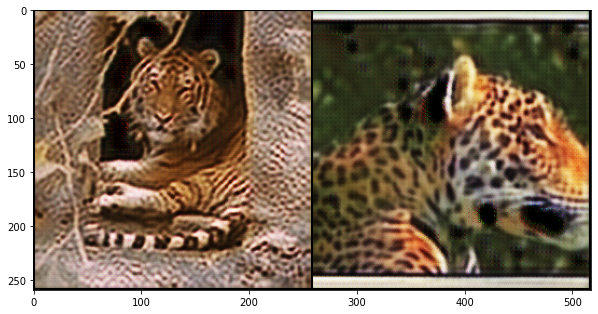

Epoch 0: Step 900: Generator (U-Net) loss: 5.203820176124573, Discriminator loss: 0.23884550020098674


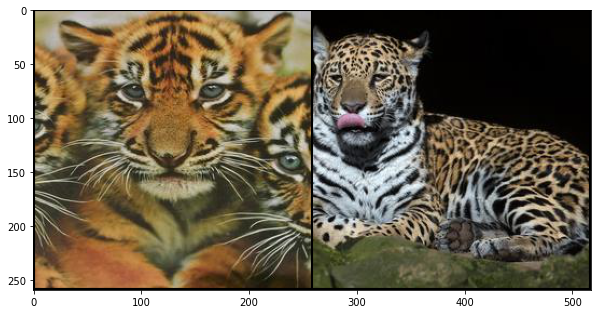

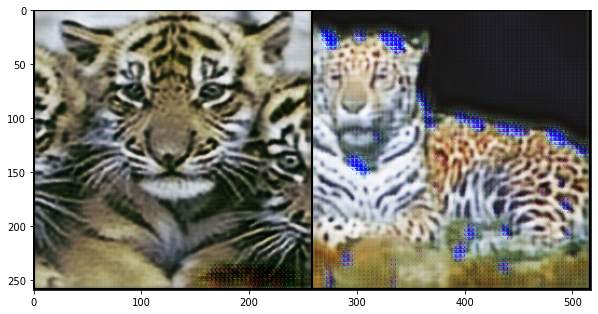

Epoch 1: Step 1000: Generator (U-Net) loss: 5.1874613952636714, Discriminator loss: 0.22474369496107102


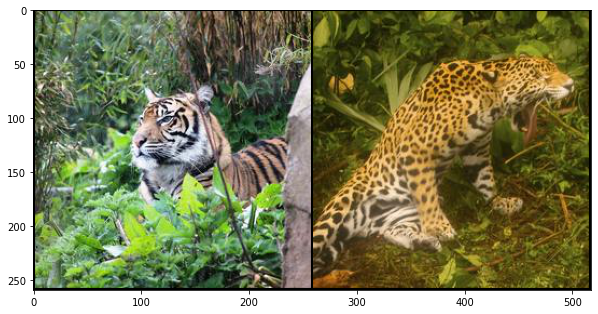

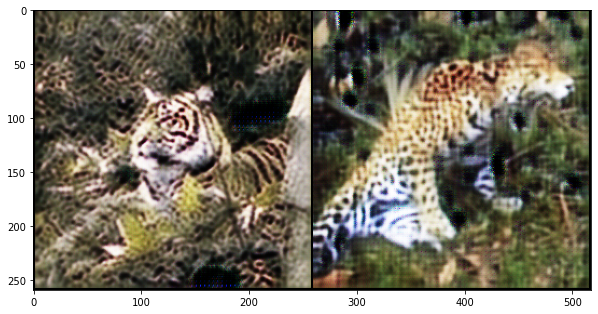

Epoch 1: Step 1100: Generator (U-Net) loss: 5.073270535469053, Discriminator loss: 0.22654354751110078


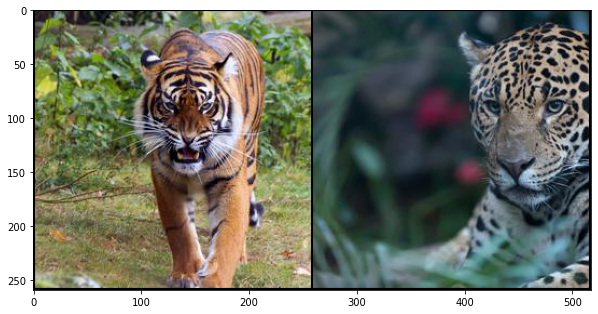

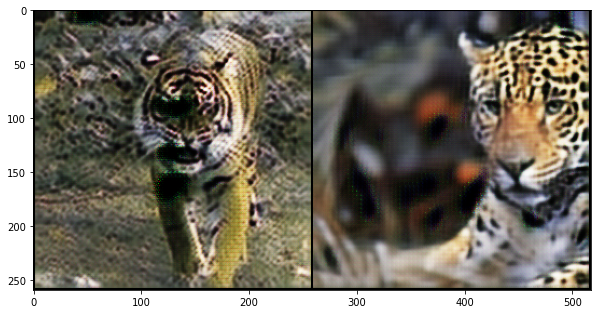

Epoch 1: Step 1200: Generator (U-Net) loss: 4.9302643013000464, Discriminator loss: 0.24433109775185585


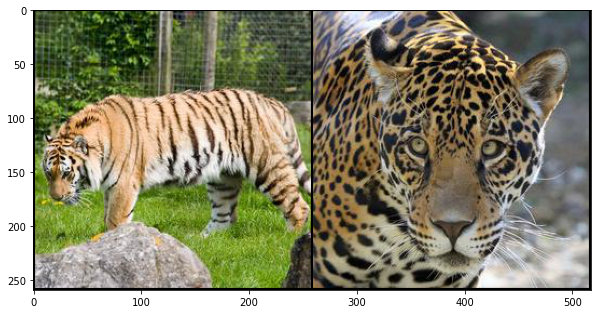

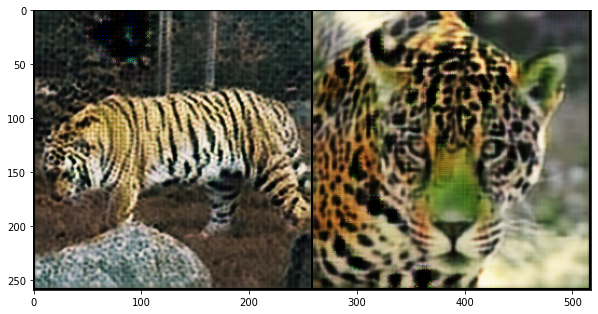

Epoch 1: Step 1300: Generator (U-Net) loss: 5.121031460762026, Discriminator loss: 0.21734807789325708


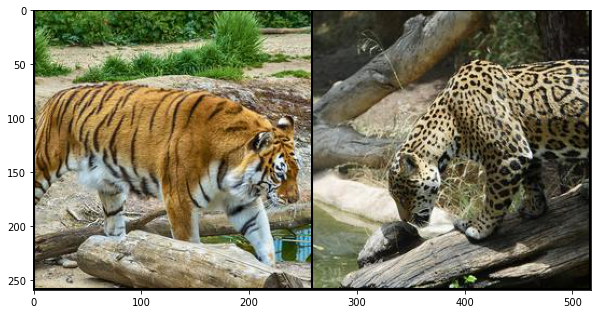

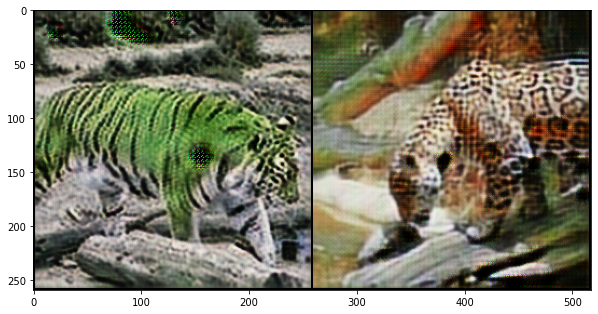

Epoch 1: Step 1400: Generator (U-Net) loss: 5.5290863299369795, Discriminator loss: 0.1443397117033601


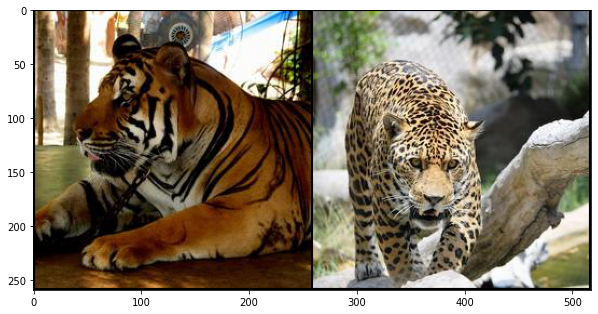

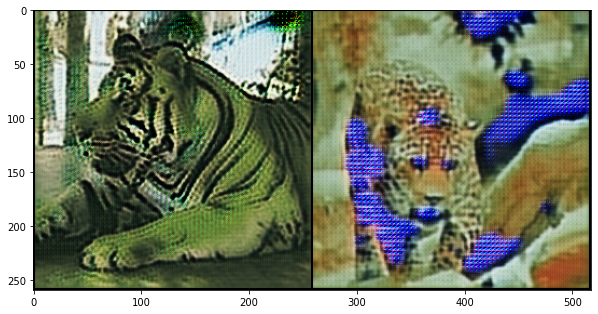

Epoch 1: Step 1500: Generator (U-Net) loss: 5.52090414047241, Discriminator loss: 0.07753408763557672


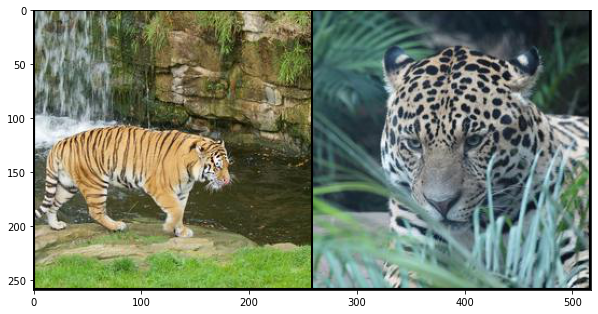

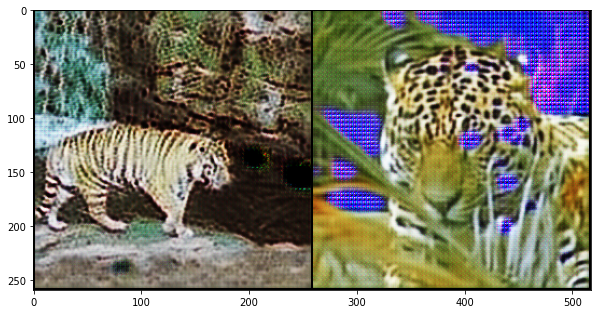

Epoch 1: Step 1600: Generator (U-Net) loss: 5.3202472734451325, Discriminator loss: 0.11905612934380772


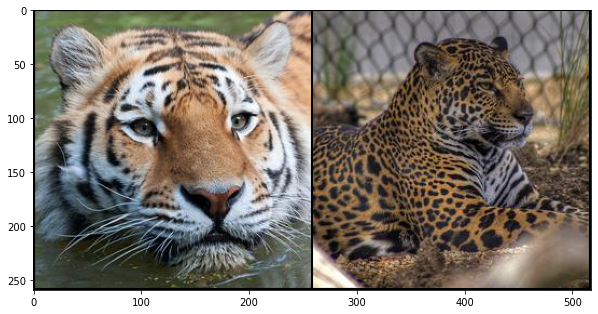

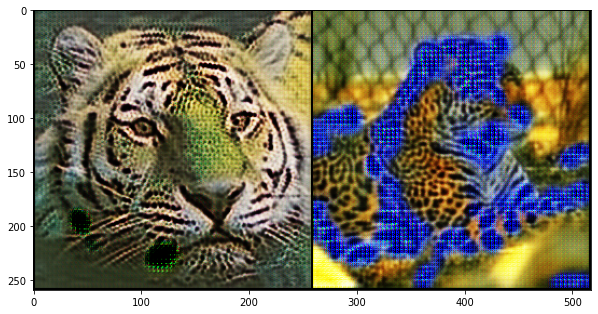

Epoch 1: Step 1700: Generator (U-Net) loss: 5.595925273895261, Discriminator loss: 0.12545232169330114


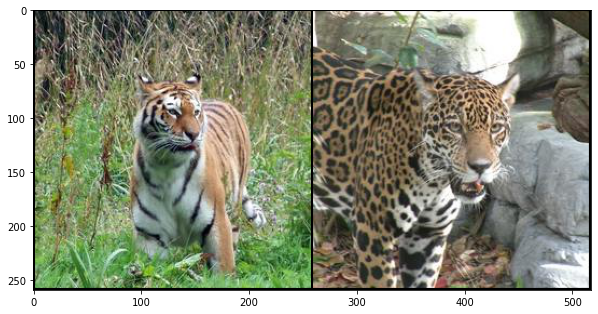

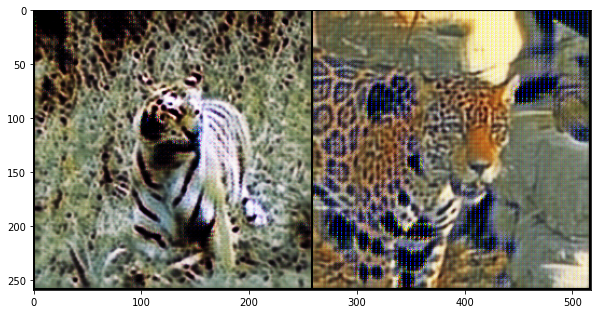

Epoch 1: Step 1800: Generator (U-Net) loss: 5.399108402729034, Discriminator loss: 0.17689318921416994


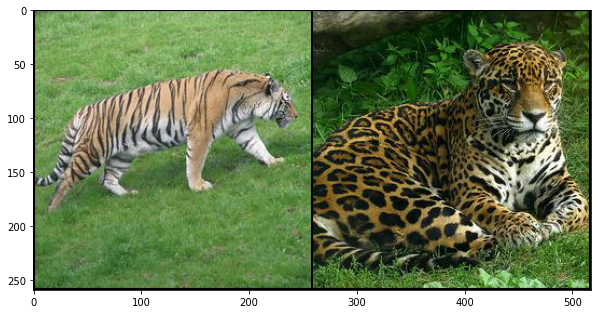

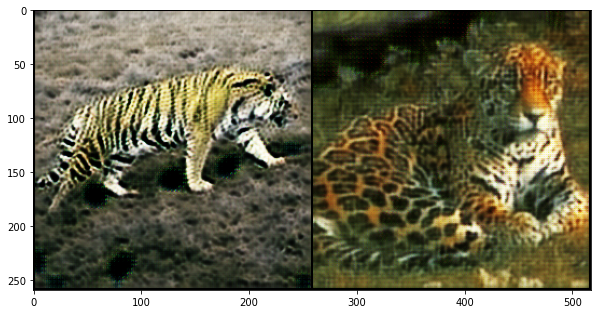

Epoch 1: Step 1900: Generator (U-Net) loss: 5.411938910484312, Discriminator loss: 0.21501467391848567


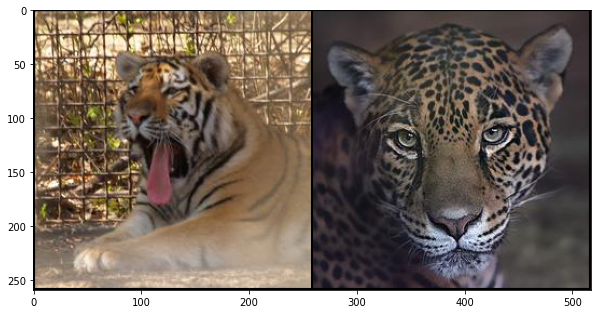

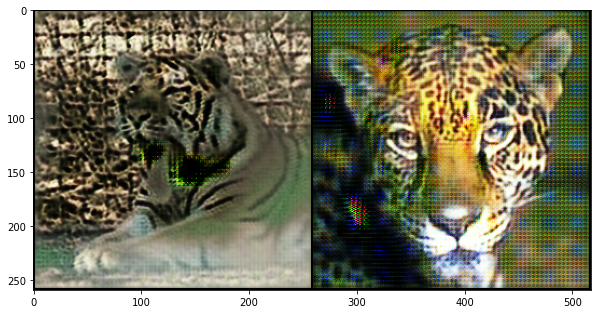

Epoch 2: Step 2000: Generator (U-Net) loss: 5.037989437580111, Discriminator loss: 0.22631046764552595


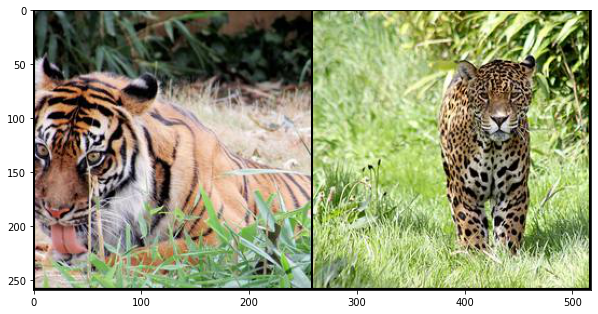

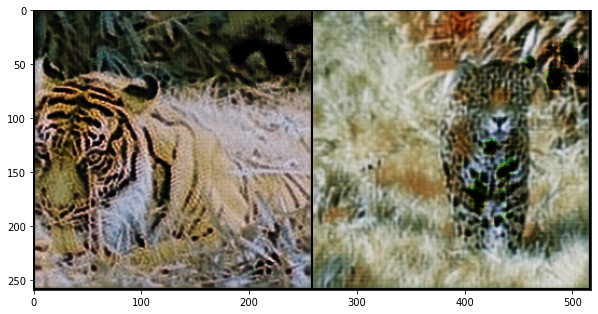

Epoch 2: Step 2100: Generator (U-Net) loss: 4.722470583915708, Discriminator loss: 0.2234902087599039


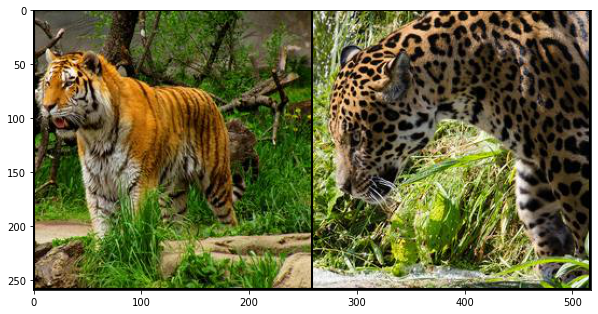

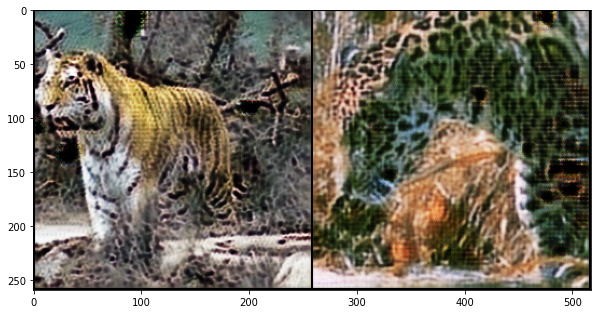

Epoch 2: Step 2200: Generator (U-Net) loss: 5.000894613265992, Discriminator loss: 0.22898293502628797


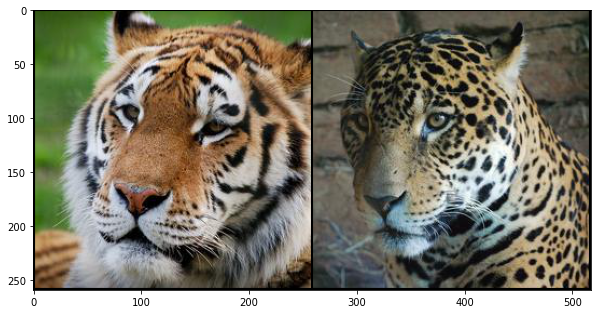

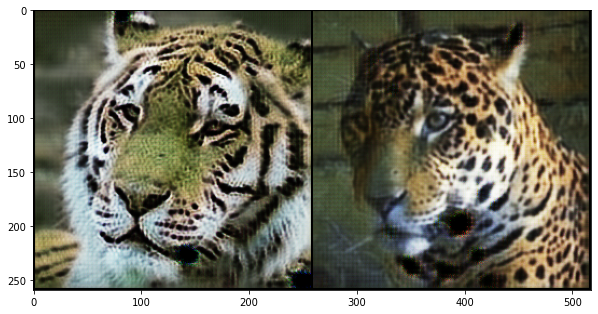

Epoch 2: Step 2300: Generator (U-Net) loss: 4.545410037040711, Discriminator loss: 0.22694739907979966


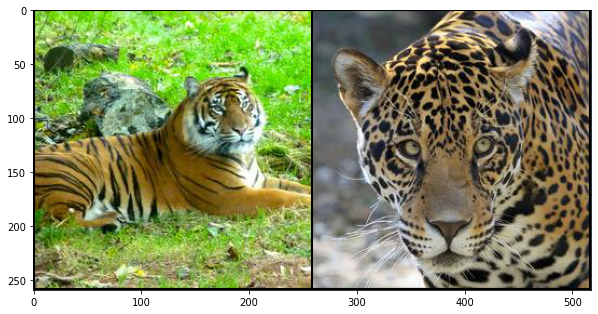

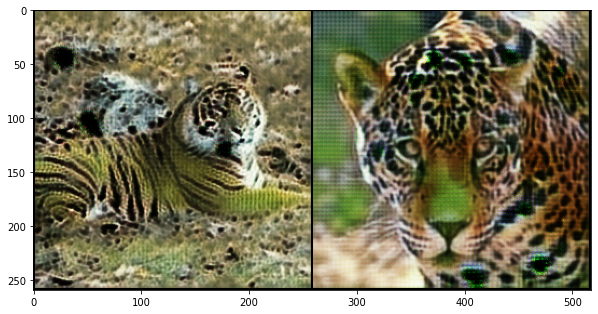

Epoch 2: Step 2400: Generator (U-Net) loss: 4.778238220214843, Discriminator loss: 0.21306092582643033


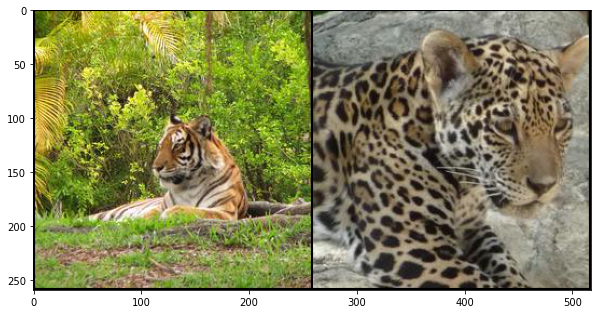

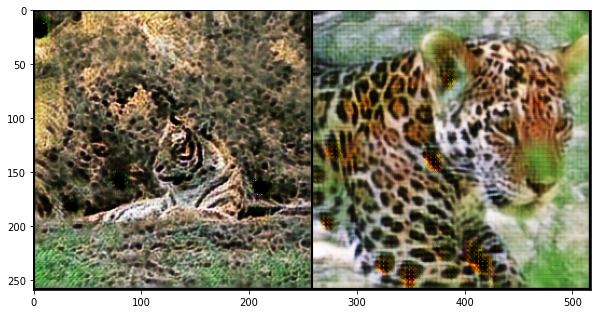

Epoch 2: Step 2500: Generator (U-Net) loss: 4.620183489322663, Discriminator loss: 0.2173644957691431


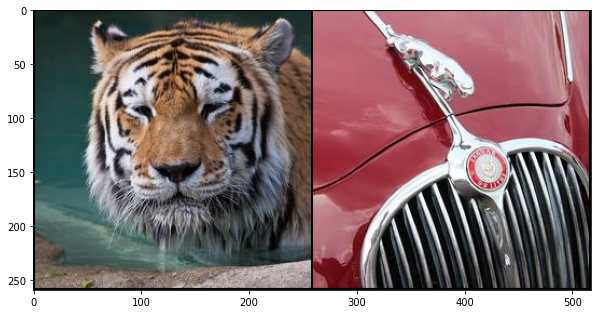

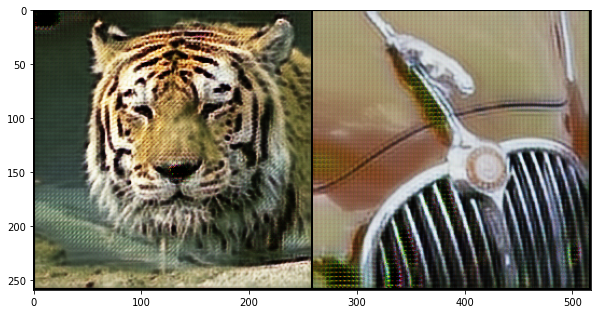

Epoch 2: Step 2600: Generator (U-Net) loss: 4.868295550346373, Discriminator loss: 0.20481154933571813


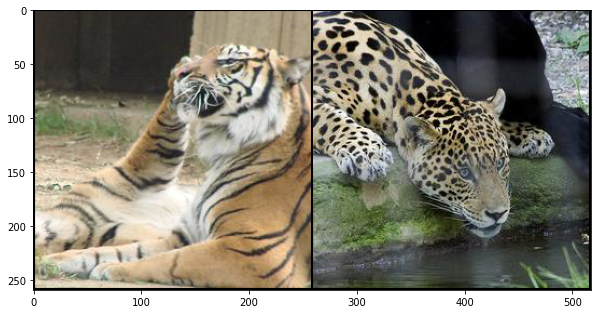

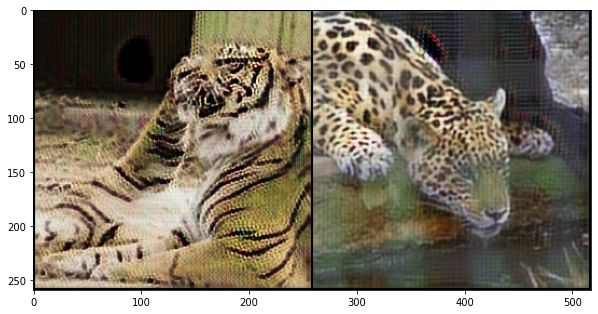

Epoch 2: Step 2700: Generator (U-Net) loss: 4.820927147865296, Discriminator loss: 0.2297378726303577


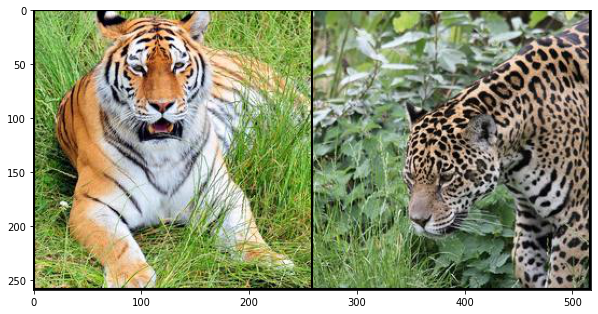

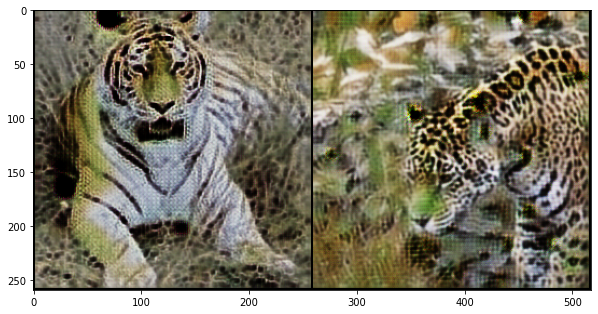

Epoch 2: Step 2800: Generator (U-Net) loss: 4.819925873279574, Discriminator loss: 0.22620642945170405


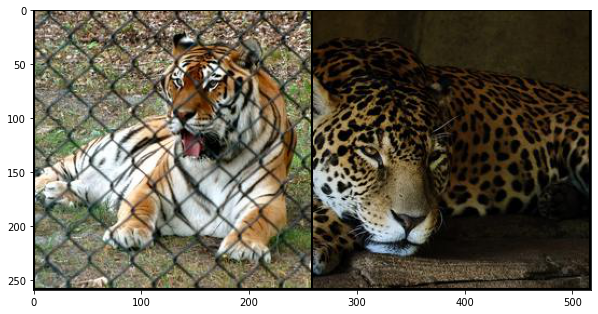

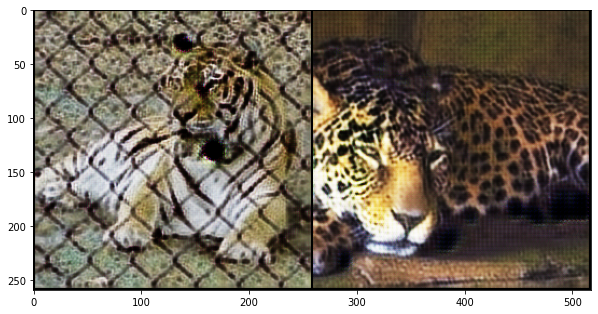

Epoch 3: Step 2900: Generator (U-Net) loss: 4.570057528018952, Discriminator loss: 0.22861119568347932


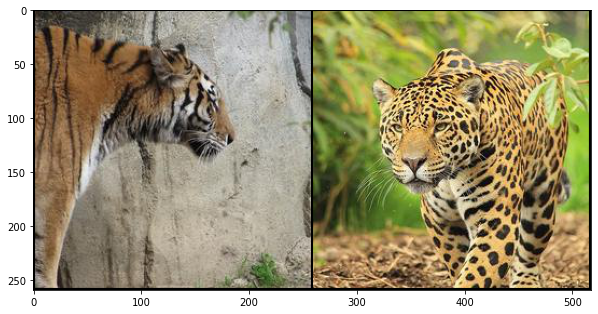

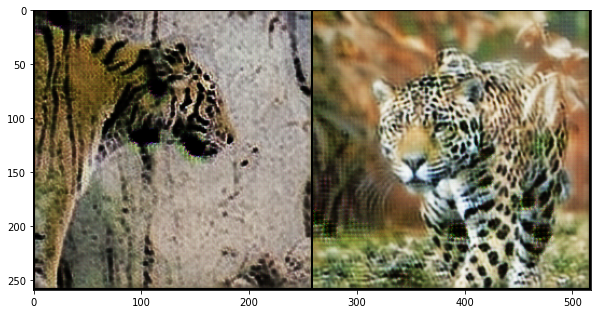

Epoch 3: Step 3000: Generator (U-Net) loss: 4.679368698596957, Discriminator loss: 0.20994497798383235


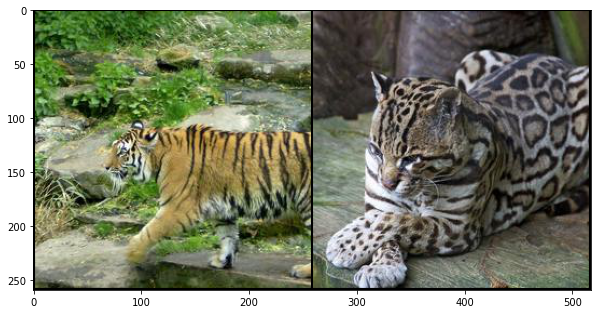

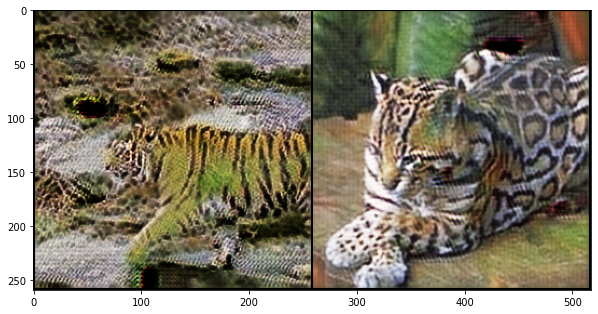

Epoch 3: Step 3100: Generator (U-Net) loss: 4.574811961650849, Discriminator loss: 0.2290223290771246


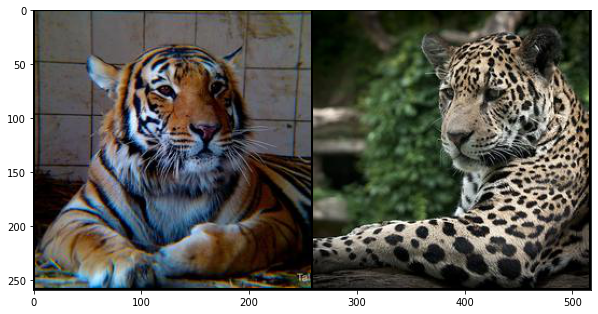

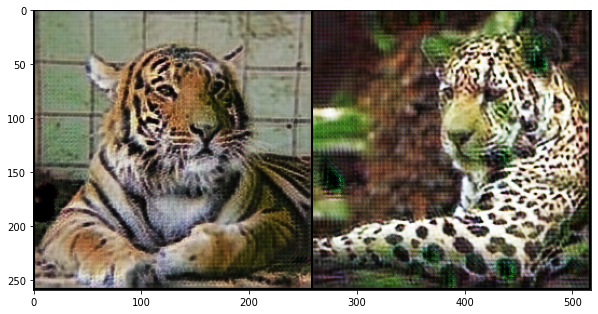

Epoch 3: Step 3200: Generator (U-Net) loss: 4.467691378593447, Discriminator loss: 0.2094606813043355


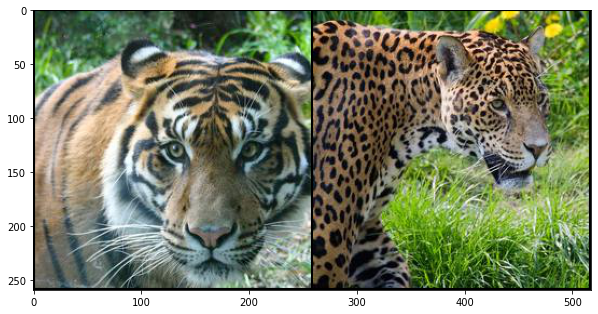

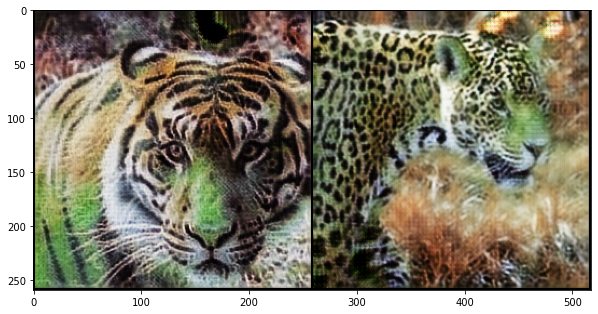

Epoch 3: Step 3300: Generator (U-Net) loss: 4.57758868932724, Discriminator loss: 0.20540347047150126


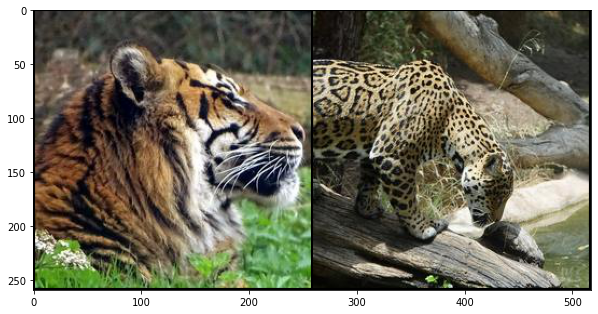

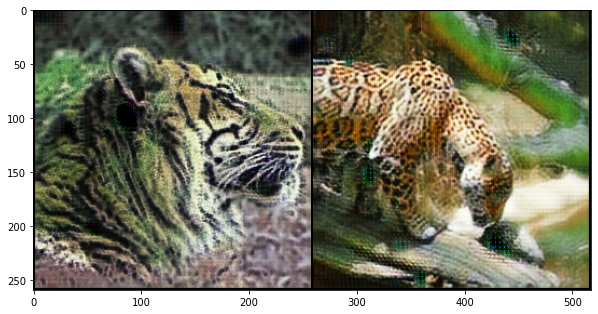

Epoch 3: Step 3400: Generator (U-Net) loss: 4.599355804920197, Discriminator loss: 0.21332984268665323


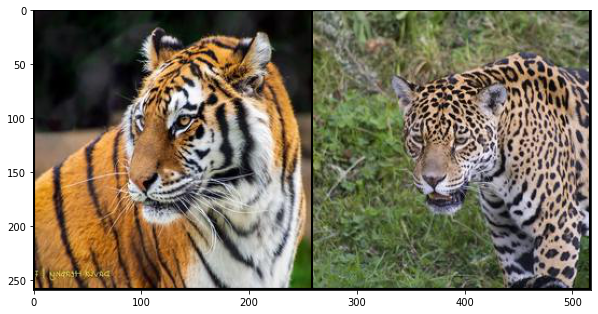

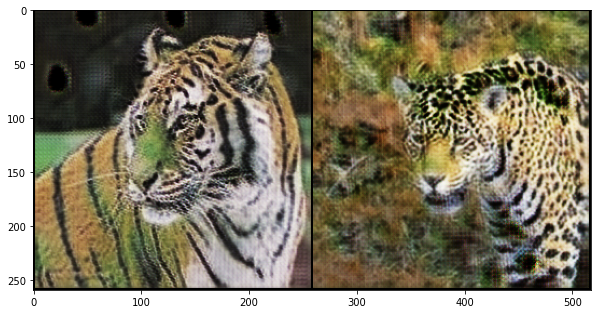

Epoch 3: Step 3500: Generator (U-Net) loss: 4.44662944316864, Discriminator loss: 0.21675702705979344


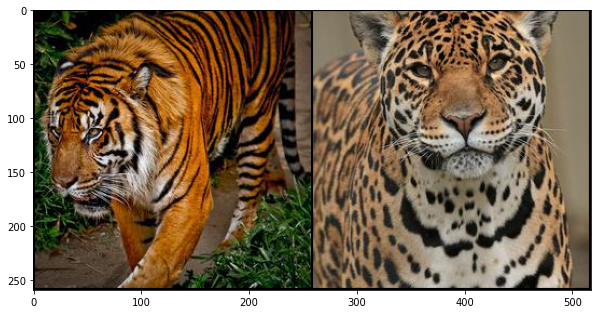

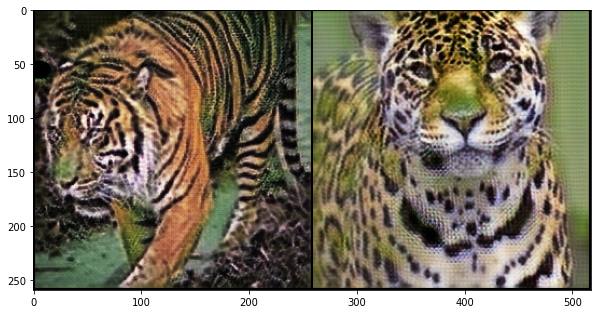

Epoch 3: Step 3600: Generator (U-Net) loss: 4.794070889949798, Discriminator loss: 0.2115494474768638


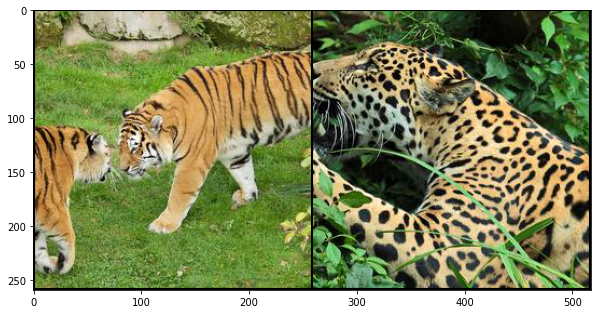

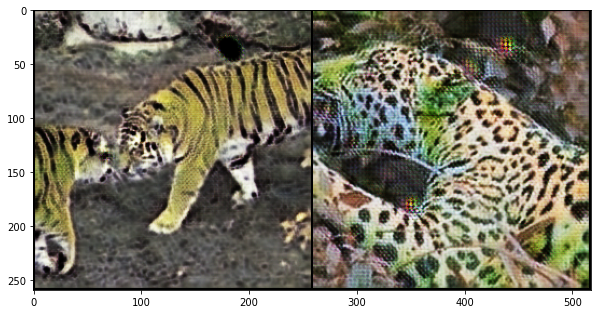

Epoch 3: Step 3700: Generator (U-Net) loss: 4.51984118938446, Discriminator loss: 0.21492384888231758


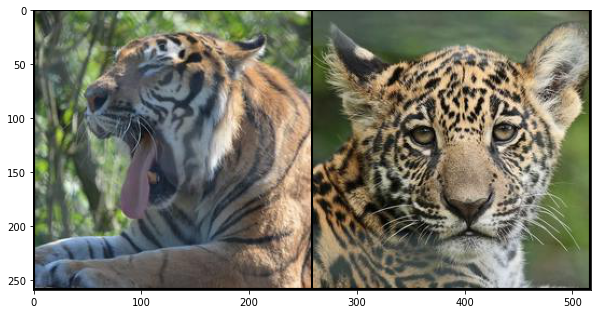

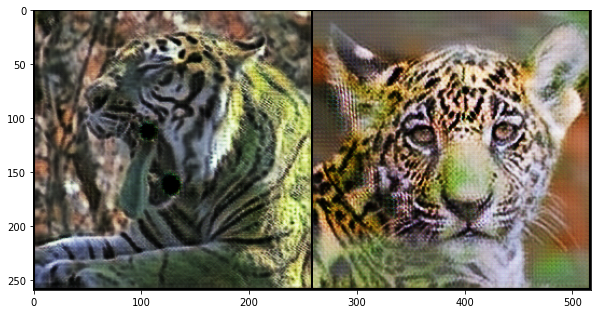

Epoch 3: Step 3800: Generator (U-Net) loss: 4.390771839618685, Discriminator loss: 0.2237271311879158


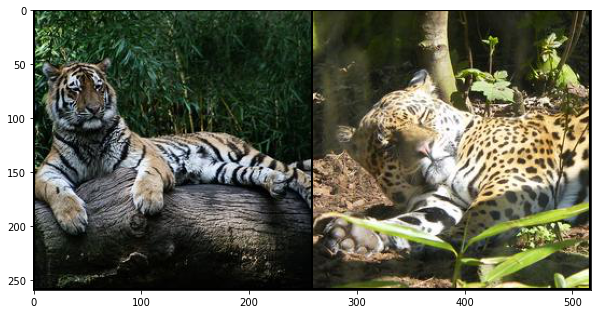

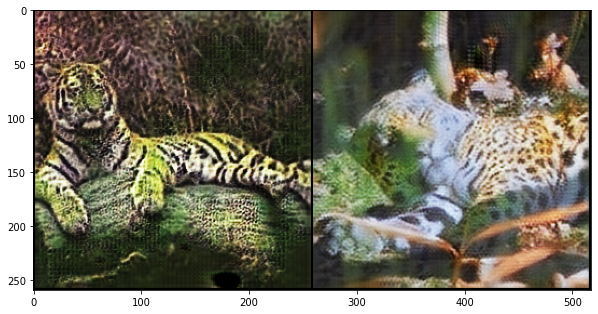

Epoch 4: Step 3900: Generator (U-Net) loss: 4.644838309288025, Discriminator loss: 0.2109841859340668


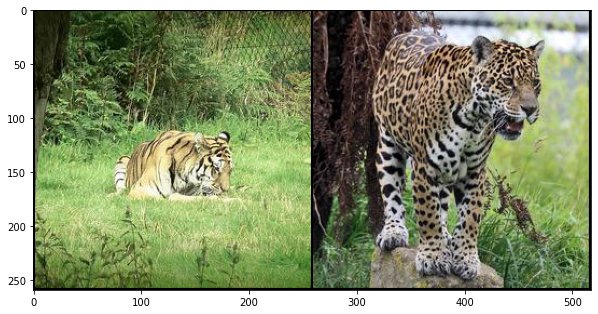

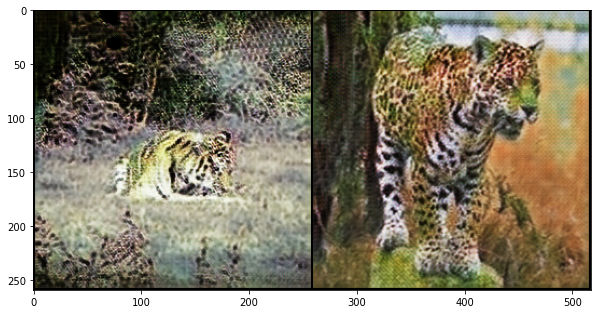

Epoch 4: Step 4000: Generator (U-Net) loss: 4.2315573167800915, Discriminator loss: 0.2202829815447332


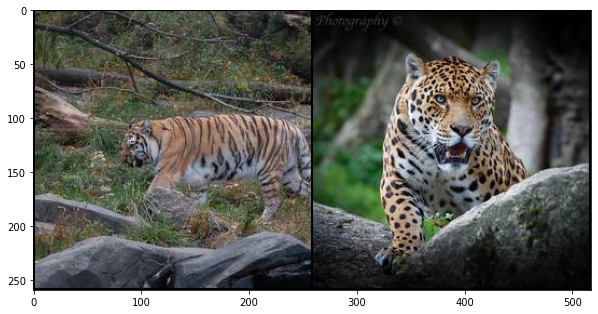

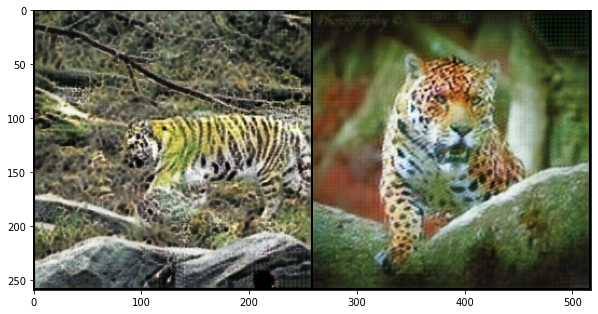

Epoch 4: Step 4100: Generator (U-Net) loss: 4.632297718524934, Discriminator loss: 0.21091163367032992


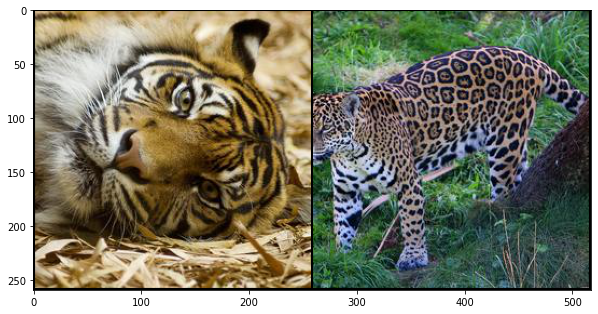

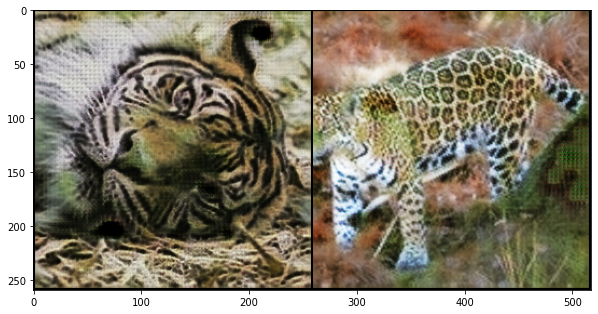

Epoch 4: Step 4200: Generator (U-Net) loss: 4.314582602977753, Discriminator loss: 0.21932132355868825


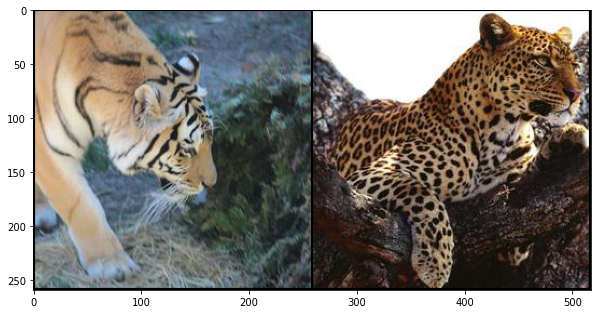

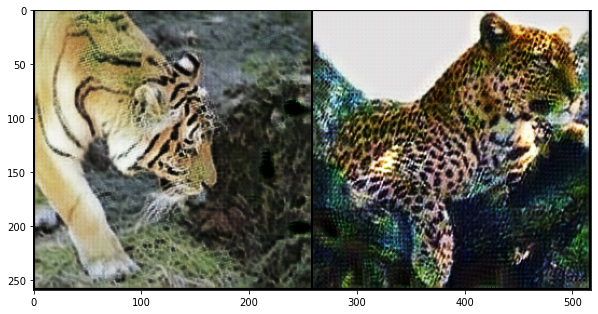

Epoch 4: Step 4300: Generator (U-Net) loss: 4.464649565219877, Discriminator loss: 0.2250040678679944


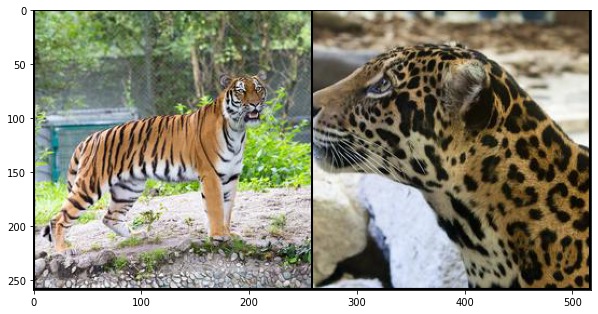

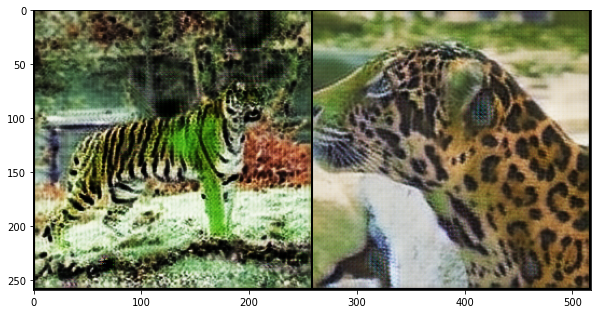

Epoch 4: Step 4400: Generator (U-Net) loss: 4.298754129409789, Discriminator loss: 0.2221920779347419


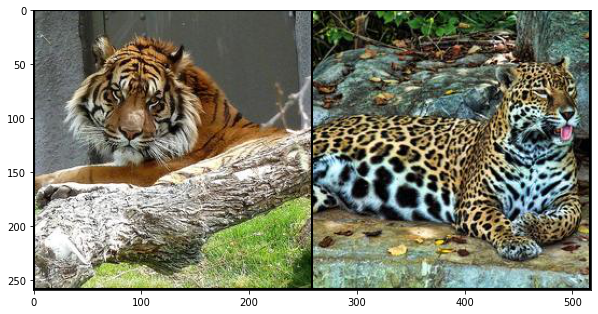

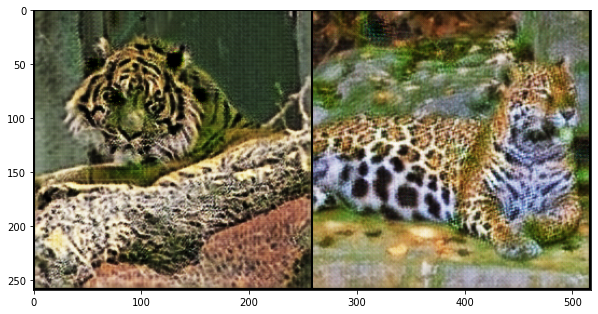

Epoch 4: Step 4500: Generator (U-Net) loss: 4.443486008644104, Discriminator loss: 0.2041110353171825


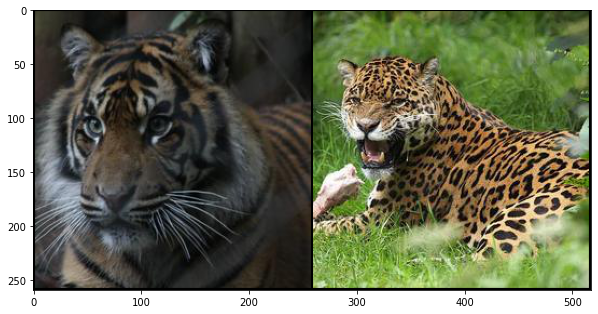

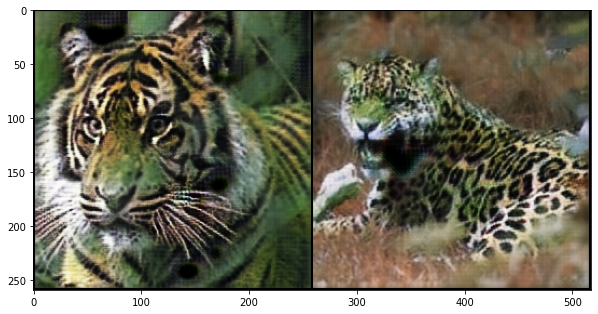

Epoch 4: Step 4600: Generator (U-Net) loss: 4.562990605831147, Discriminator loss: 0.22112288609147074


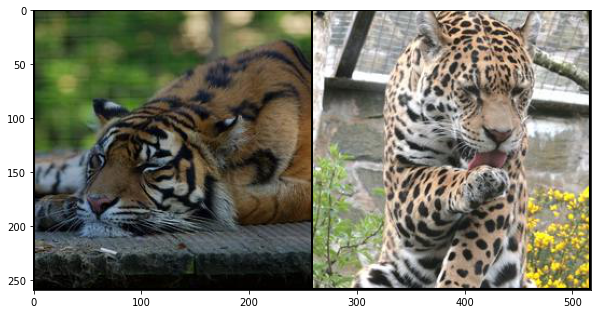

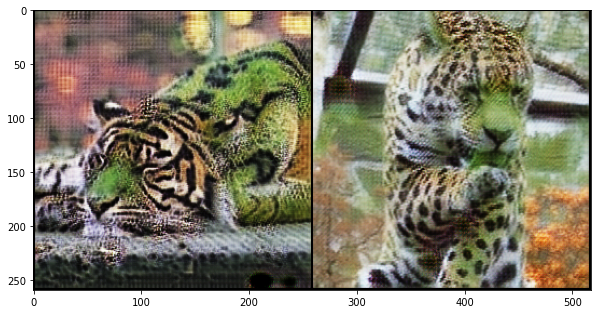

Epoch 4: Step 4700: Generator (U-Net) loss: 4.401896479129791, Discriminator loss: 0.21312817357480524


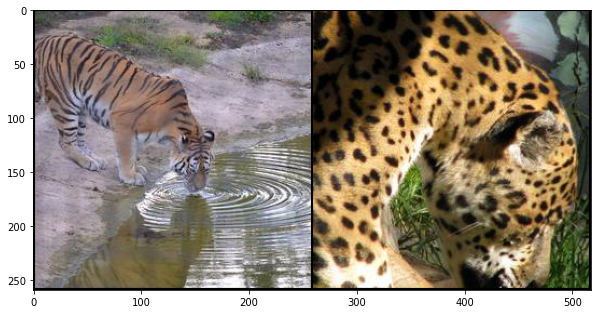

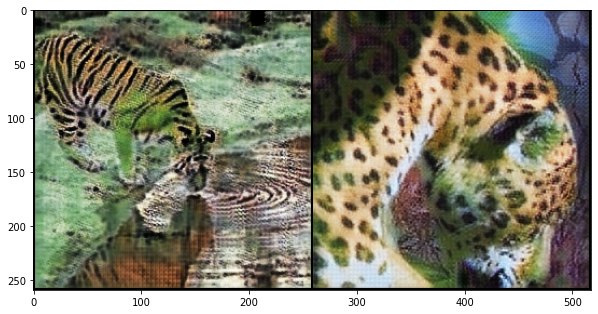

Epoch 5: Step 4800: Generator (U-Net) loss: 4.150787680149076, Discriminator loss: 0.23478231631219396


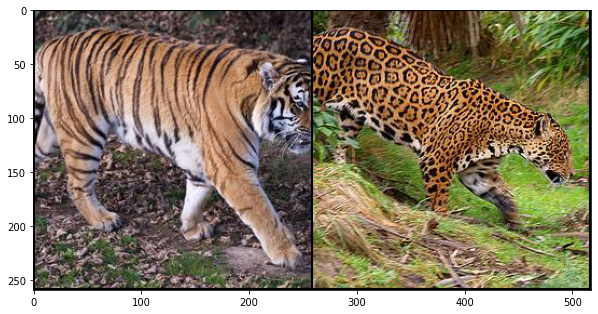

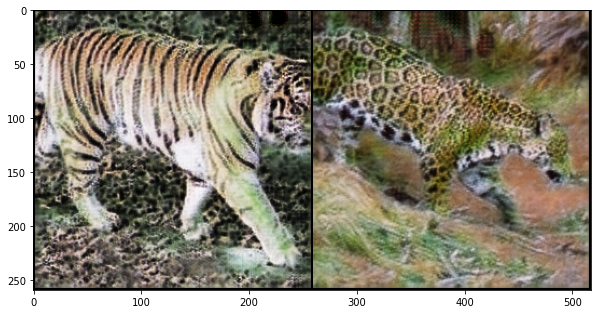

Epoch 5: Step 4900: Generator (U-Net) loss: 4.141548500061036, Discriminator loss: 0.2112084229290486


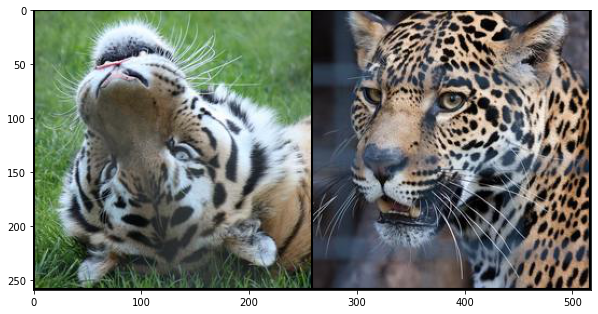

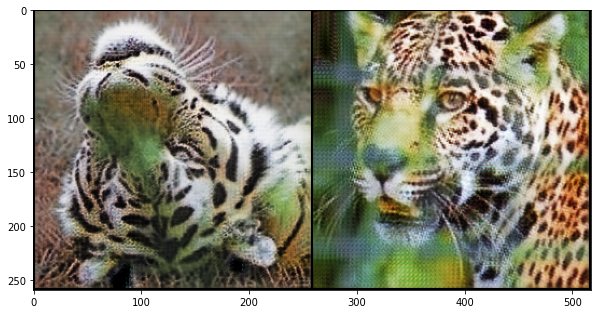

Epoch 5: Step 5000: Generator (U-Net) loss: 4.392360177040097, Discriminator loss: 0.2116140864789486


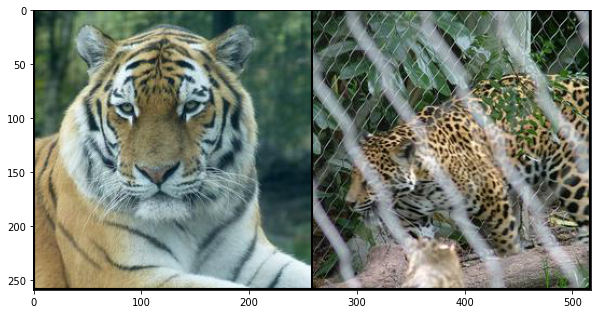

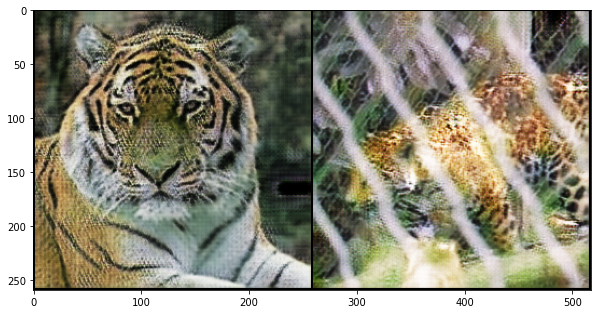

Epoch 5: Step 5100: Generator (U-Net) loss: 4.375588650703431, Discriminator loss: 0.21965632073581215


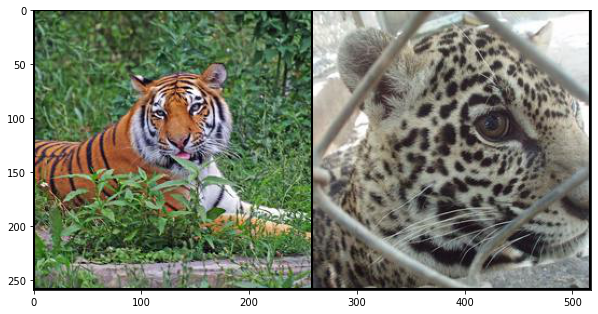

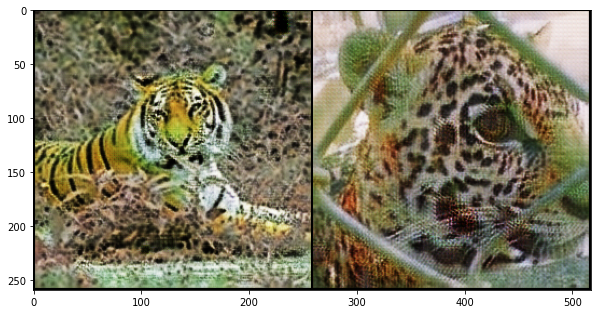

Epoch 5: Step 5200: Generator (U-Net) loss: 4.317122614383699, Discriminator loss: 0.2201122684776783
Buffered data was truncated after reaching the output size limit.

In [ ]:
from skimage import color
import numpy as np
plt.rcParams["figure.figsize"] = (10, 10)


def train(save_model=False):
    mean_generator_loss = 0
    mean_discriminator_loss = 0
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
    cur_step = 0
    for epoch in range(n_epochs):

        for real_A, real_B in tqdm(dataloader):
            real_A = nn.functional.interpolate(real_A, size=target_shape)
            real_B = nn.functional.interpolate(real_B, size=target_shape)
            real_A = real_A.to(device)
            real_B = real_B.to(device)
            ### Update discriminator A ###
            disc_A_opt.zero_grad() # Zero out the gradient before backpropagation
            with torch.no_grad():
                fake_A = gen_BA(real_B)
            disc_A_loss = get_disc_loss(real_A, fake_A, disc_A, adv_criterion)
            disc_A_loss.backward(retain_graph=False) # Update gradients
            disc_A_opt.step() # Update optimizer

            ### Update discriminator B ###
            disc_B_opt.zero_grad() # Zero out the gradient before backpropagation
            with torch.no_grad():
                fake_B = gen_AB(real_A)
            disc_B_loss = get_disc_loss(real_B, fake_B, disc_B, adv_criterion)
            disc_B_loss.backward(retain_graph=False) # Update gradients
            disc_B_opt.step() # Update optimizer

            ### Update generator ###
            gen_opt.zero_grad()
            gen_loss, fake_A, fake_B = get_gen_loss(
                real_A, real_B, gen_AB, gen_BA, disc_A, disc_B, adv_criterion, recon_criterion, recon_criterion
            )
            gen_loss.backward() # Update gradients
            gen_opt.step() # Update optimizer

            # Keep track of the average discriminator loss
            mean_discriminator_loss += disc_A_loss.item() / display_step
            # Keep track of the average generator loss
            mean_generator_loss += gen_loss.item() / display_step

            ### Visualization code ###
            if cur_step % display_step == 0:
                print(f"Epoch {epoch}: Step {cur_step}: Generator (U-Net) loss: {mean_generator_loss}, Discriminator loss: {mean_discriminator_loss}")
                show_tensor_images(torch.cat([real_A, real_B]), size=(dim_A, target_shape, target_shape))
                show_tensor_images(torch.cat([fake_B, fake_A]), size=(dim_B, target_shape, target_shape))
                mean_generator_loss = 0
                mean_discriminator_loss = 0
                # You can change save_model to True if you'd like to save the model
                if save_model:
                    torch.save({
                        'gen_AB': gen_AB.state_dict(),
                        'gen_BA': gen_BA.state_dict(),
                        'gen_opt': gen_opt.state_dict(),
                        'disc_A': disc_A.state_dict(),
                        'disc_A_opt': disc_A_opt.state_dict(),
                        'disc_B': disc_B.state_dict(),
                        'disc_B_opt': disc_B_opt.state_dict()
                    }, f"cycleGAN_{cur_step}.pth")
            cur_step += 1
train(save_model=True)

In [ ]:
fake_A.shape

NameError: ignored